In [1]:
import tqdm
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px

In [2]:
beta = 1  #β
f = 1     #f
gamma = 1 #γ

In [3]:
psi = [0.9 * np.pi] #ψ
omega = [0]         #ω
phi = [0]           #φ

$$
{F_{resistance}}_n = -b {\omega} \\
{F_{gravity}}_n = -mg \sin \psi \\
{F_{periodic}}_n = F \cos \Omega t
$$

$$
{\omega}_0^2 = \frac{k}{m};\quad \beta = \frac{b}{m {\omega}_0};\quad f = \frac{F}{m {\omega}_0^2};\quad \gamma = \frac{\Omega}{{\omega}_0}
$$

$$
\tau = {\omega}_0t;\quad \overset{\circ}{x} = \frac{dx}{d\tau}
$$

$$
\begin{cases}
\overset{\circ}{\psi} = \omega, \\
\overset{\circ}{\omega} = -\beta \omega - \sin \psi + f \cos \phi, \\
\overset{\circ}{\phi} = \gamma, \quad \phi \mod 2\pi
\end{cases}
$$

In [4]:
dtau = 5e-4
tau_end = 100
tau = [0]
for tau_now in tqdm.tqdm(np.arange(0, tau_end + dtau, dtau)):
    psi.append(psi[-1] + omega[-1] * dtau)
    omega.append(omega[-1] + (-beta * omega[-1] - np.sin(psi[-1]) + f * np.cos(phi[-1])) * dtau)
    phi.append(phi[-1] + gamma * dtau)
    tau.append(tau_now)

100%|██████████| 200001/200001 [00:00<00:00, 405927.10it/s]


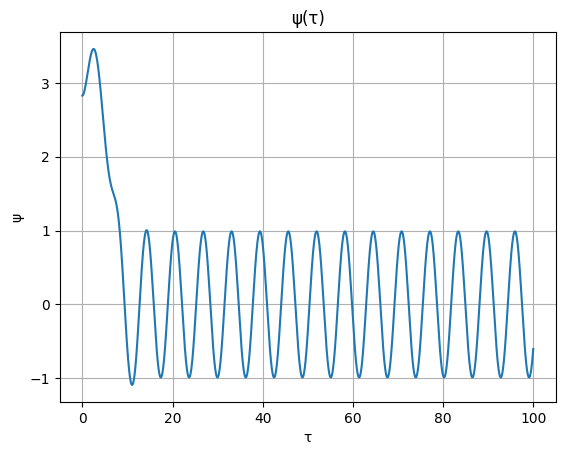

In [5]:
plt.plot(tau, psi)
plt.title('ψ(τ)')
plt.xlabel('τ')
plt.ylabel('ψ')
plt.grid()

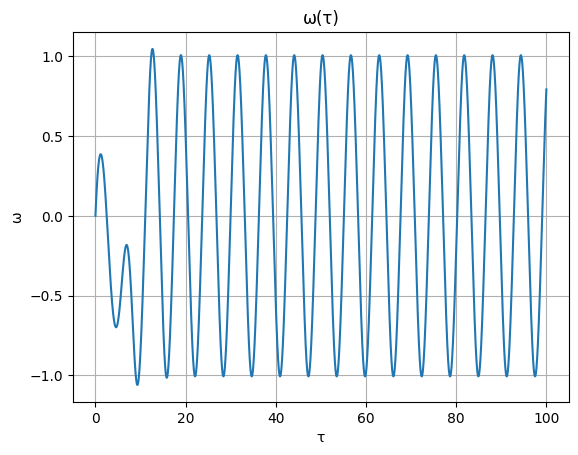

In [6]:
plt.plot(tau, omega)
plt.title('ω(τ)')
plt.xlabel('τ')
plt.ylabel('ω')
plt.grid()

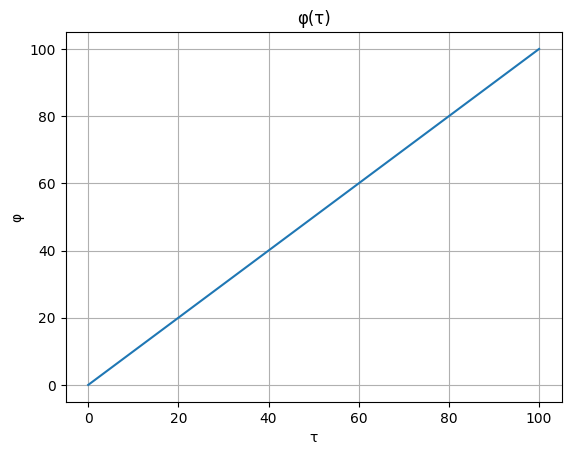

In [7]:
plt.plot(tau, phi)
plt.title('φ(τ)')
plt.xlabel('τ')
plt.ylabel('φ')
plt.grid()

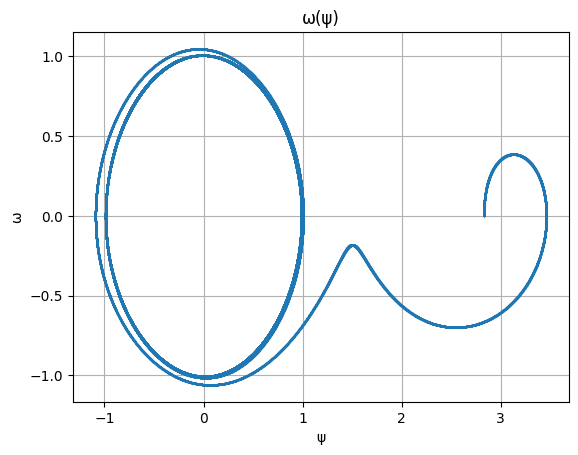

In [8]:
plt.plot(psi, omega, linestyle='', marker='.', markersize=0.5)
plt.title('ω(ψ)')
plt.xlabel('ψ')
plt.ylabel('ω')
plt.grid()

Text(0.5, 0, 'φ')

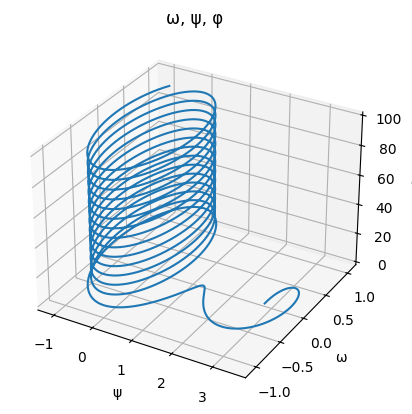

In [9]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.plot(psi, omega, phi)
plt.title('ω, ψ, φ')
ax.set_xlabel('ψ')
ax.set_ylabel('ω')
ax.set_zlabel('φ')

In [10]:
df = pd.DataFrame(
    {
        'ψ': psi,
        'ω': omega,
        'φ': phi,
    }
)
fig = px.line_3d(df, x='ψ', y='ω', z='φ')
fig.show()

Text(0.5, 0, 'φ')

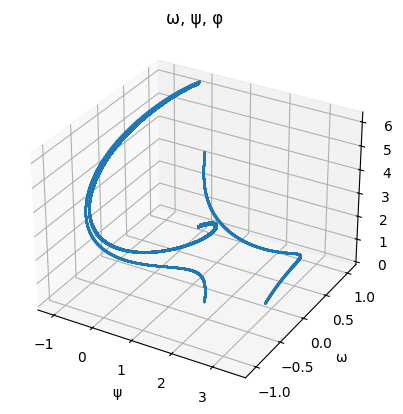

In [11]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.plot(psi, omega, np.array(phi) % (2 * np.pi), linestyle='', marker='.', markersize=0.5)
plt.title('ω, ψ, φ')
ax.set_xlabel('ψ')
ax.set_ylabel('ω')
ax.set_zlabel('φ')

In [12]:
df = pd.DataFrame(
    {
        'ψ': psi,
        'ω': omega,
        'φ': np.array(phi) % (2 * np.pi),
    }
)
fig = px.line_3d(df, x='ψ', y='ω', z='φ')
fig.show()